In [1]:
from argparse import ArgumentParser
import os
import sys
import random
import logging
import matplotlib.pyplot as plt
import numpy as np

from scipy import integrate
from sklearn.metrics import mean_squared_error as MSE
import copy

from tqdm.auto import tqdm, trange
from tqdm.contrib import tenumerate

import torch
from torch.utils.data import DataLoader

/opt/homebrew/anaconda3/envs/Diss/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
from IPython.display import SVG, display
import plotly.graph_objects as go
import plotly.express as px

%matplotlib inline 
%config InlineBackend.figure_format='retina'
%load_ext autoreload 
%autoreload 2

def imshow(fig):
    return display(SVG(fig.to_image(format="svg")))

In [3]:
sys.path.append("../src")
from plotter import *
from model import DeepSTPP, log_ft, t_intensity, s_intensity
from data.dataset import SlidingWindowWrapper
#from data.adapter import DataAdapter
from data.synthetic import *

In [4]:
"""The code below is used to set up customized training device on computer"""
if torch.cuda.is_available():
    device = torch.device('cuda:0')
    print("You are using GPU acceleration.")
    print("Device name: ", torch.cuda.get_device_name(0))
    print("Number of CUDAs(cores): ", torch.cuda.device_count())
else:
    device = torch.device("cpu")
    print("CUDA is not Available. You are using CPU only.")
    print("Number of cores: ", os.cpu_count())

CUDA is not Available. You are using CPU only.
Number of cores:  8


In [5]:
class AverageMeter(object):
    """Computes and stores the average and current value"""

    def __init__(self):
        self.reset()

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count

In [6]:
def visualize_diff(outputs, targets, portion=1):
    outputs = outputs[:int(len(outputs) * portion)]
    targets = targets[:int(len(targets) * portion)]

    plt.figure(figsize=(14, 10), dpi=180)
    plt.subplot(2, 2, 1)

    n = outputs.shape[0]
    lookahead = outputs.shape[1]

    for i in range(lookahead):
        plt.plot(range(i, n), outputs[:n - i, i, 0], "-o", label=f"Predicted {i} step")
    plt.plot(targets[:, 0, 0], "-o", color="b", label="Actual")
    plt.ylabel('Latitude')
    plt.legend()

    plt.subplot(2, 2, 2)
    for i in range(lookahead):
        plt.plot(range(i, n), outputs[:n - i, i, 1], "-o", label=f"Predicted {i} step")
    plt.plot(targets[:, 0, 1], "-o", color="b", label="Actual")
    plt.ylabel('Longitude')
    plt.legend()

    plt.subplot(2, 2, 3)
    for i in range(lookahead):
        plt.plot(range(i, n), outputs[:n - i, i, 2], "-o", label=f"Predicted {i} step")
    plt.plot(targets[:, 0, 2], "-o", color="b", label="Actual")
    plt.ylabel('delta_t (hours)')
    plt.legend()
    plt.savefig('result.png')

In [7]:
class Namespace:
    def __init__(self, **kwargs):
        self.__dict__.update(kwargs)

config = Namespace(hid_dim=128, num_class=369, emb_dim=128, out_dim=0, n_layers=1, 
                   lr=0.0003, momentum=0.9, epochs=50, batch=128, opt='Adam', generate_type=True,
                   read_model=False, seq_len=20, eval_epoch=5,
                   lookahead=1, alpha=0.1, z_dim=128, beta=1e-3, dropout=0, num_head=2,
                   nlayers=3, num_points=20, infer_nstep=10000, infer_limit=13,decoder_n_layer=3,sample=True,constrain_b='sigmoid',b_max=20,s_min=1e-3)



# config = Namespace(hid_dim=128, emb_dim=128, out_dim=0,
#                     lr=0.00003, momentum=0.9, epochs=N_EPOCHS, batch=BATCH_SIZE, opt='Adam', generate_type=True,
#                     read_model=False, seq_len=FORWARD_SEQ_LEN, eval_epoch=EVAL_EPOCHS, s_min=1e-3, b_max=20,
#                     lookahead=2, alpha=0.1, z_dim=128, beta=1e-3, dropout=0, num_head=2,
#                     nlayers=3, num_points=NUM_BACKGROUND_POINTS, infer_nstep=10000, infer_limit=13, clip=1.0,
#                     constrain_b='sigmoid', sample=True, decoder_n_layer=3)

In [8]:
"""
Prepare logger
"""
logger = logging.getLogger('full_lookahead{}batch{}'.format(config.lookahead, config.batch))
logger.setLevel(logging.DEBUG)
hdlr = logging.FileHandler('full_lookahead{}batch{}.log'.format(config.lookahead, config.batch))
formatter = logging.Formatter('%(asctime)s %(levelname)s %(message)s')
hdlr.setFormatter(formatter)
logger.addHandler(hdlr)

# create console handler with a higher log level
ch = logging.StreamHandler()
ch.setLevel(logging.DEBUG)
ch.setFormatter(formatter)
logger.addHandler(ch)

### Transformer-Encoder VAE (last output only)

In [9]:
def eval_loss(model, test_loader, device):
    model.eval()
    loss_total = 0
    sll_meter = AverageMeter()
    tll_meter = AverageMeter()
    loss_meter = AverageMeter()
    
    for index, data in enumerate(test_loader):
        st_x, st_y, _, _, _ = data
        loss, sll, tll = model.loss(st_x, st_y)
        
        loss_meter.update(loss.item())
        sll_meter.update(sll.mean())
        tll_meter.update(tll.mean())
        
    return loss_meter.avg, sll_meter.avg, tll_meter.avg

In [10]:
def train(model, train_loader, val_loader, config, logger, device):
    scheduler = torch.optim.lr_scheduler.StepLR(model.optimizer, step_size=50, gamma=0.2)
    best_eval = np.infty
    sll_meter = AverageMeter()
    tll_meter = AverageMeter()
    loss_meter = AverageMeter()
    
    for epoch in trange(config.epochs):
        loss_total = 0
        model.train()
        for index, data in tenumerate(train_loader):
            st_x, st_y, _, _, _ = data

            model.optimizer.zero_grad()
            loss, sll, tll = model.loss(st_x, st_y)
            loss.backward()
            model.optimizer.step()

            loss_meter.update(loss.item())
            sll_meter.update(sll.mean())
            tll_meter.update(tll.mean())

        scheduler.step()

        logger.info("In epochs {} | "
                    "total loss: {:5f} | Space: {:5f} | Time: {:5f}".format(
            epoch, loss_meter.avg, sll_meter.avg , tll_meter.avg
        ))
        if (epoch+1)%config.eval_epoch==0:
            print("Evaluate")
            valloss, valspace, valtime = eval_loss(model, val_loader, device)
            logger.info("Val Loss {:5f} | Space: {:5f} | Time: {:5f}".format(valloss, valspace, valtime))
            if valloss < best_eval:
                best_eval = valloss
                best_model = copy.deepcopy(model)

    print("training done!")
    return best_model

In [11]:
def visualize_diff(outputs, targets, portion=1):
    outputs = outputs[:int(len(outputs) * portion)]
    targets = targets[:int(len(targets) * portion)]

    plt.figure(figsize=(14, 10), dpi=180)
    plt.subplot(2, 2, 1)

    n = outputs.shape[0]
    lookahead = 1

    for i in range(lookahead):
        plt.plot(range(i, n), outputs[:n - i, i, 0], "-o", label=f"Predicted {i} step")
    plt.plot(targets[:, 0, 0], "-o", color="b", label="Actual")
    plt.ylabel('Latitude')
    plt.legend()

    plt.subplot(2, 2, 2)
    for i in range(lookahead):
        plt.plot(range(i, n), outputs[:n - i, i, 1], "-o", label=f"Predicted {i} step")
    plt.plot(targets[:, 0, 1], "-o", color="b", label="Actual")
    plt.ylabel('Longitude')
    plt.legend()

    plt.subplot(2, 2, 3)
    for i in range(lookahead):
        plt.plot(range(i, n), outputs[:n - i, i, 2], "-o", label=f"Predicted {i} step")
    plt.plot(targets[:, 0, 2], "-o", color="b", label="Actual")
    plt.ylabel('delta_t (hours)')
    plt.legend()
    plt.savefig('result.png')

## Training

In [12]:
# npzf = np.load('../src/data/processed/earthquakes_jp.npz', allow_pickle=True)
dataset = np.load('../src/data/interim/earthquakes_jp.npz', allow_pickle=True)
exclude_from_train = (dataset.files[::30] + dataset.files[1::30] + dataset.files[2::30] + dataset.files[3::30]
                      + dataset.files[4::30] + dataset.files[5::30] + dataset.files[6::30] + dataset.files[7::30]
                      + dataset.files[8::30] + dataset.files[9::30] + dataset.files[10::30])
val_files = dataset.files[3::30]
test_files = dataset.files[7::30]
train_files = list(set(dataset.files).difference(exclude_from_train))

In [13]:
# Add own preprocessing
train_data = [dataset[file] for file in train_files]
val_data = [dataset[file] for file in val_files]
test_data = [dataset[file] for file in test_files]

In [14]:
trainset = SlidingWindowWrapper(train_data, normalized=True)
valset   = SlidingWindowWrapper(val_data,   normalized=True, min=trainset.min, max=trainset.max)
testset  = SlidingWindowWrapper(test_data,  normalized=True, min=trainset.min, max=trainset.max)

In [15]:
train_loader = DataLoader(trainset, batch_size=config.batch, shuffle=True)
val_loader   = DataLoader(valset,   batch_size=config.batch, shuffle=False)
test_loader  = DataLoader(testset,  batch_size=config.batch, shuffle=False)

In [16]:
model = DeepSTPP(config, device)
best_model = train(model, train_loader, val_loader, config, logger, device)

100%|██████████| 416/416 [00:18<00:00, 22.17it/s]
2023-03-28 18:34:21,820 INFO In epochs 0 | total loss: 0.713123 | Space: 0.922180 | Time: 1.922654
100%|██████████| 416/416 [00:19<00:00, 21.18it/s]
2023-03-28 18:34:41,460 INFO In epochs 1 | total loss: 0.355344 | Space: 1.315358 | Time: 1.958063
100%|██████████| 416/416 [00:18<00:00, 21.95it/s]
2023-03-28 18:35:00,414 INFO In epochs 2 | total loss: 0.235796 | Space: 1.457643 | Time: 1.973797
100%|██████████| 416/416 [00:18<00:00, 22.41it/s]
2023-03-28 18:35:18,979 INFO In epochs 3 | total loss: 0.175961 | Space: 1.531825 | Time: 1.983262
100%|██████████| 416/416 [00:18<00:00, 22.40it/s]
2023-03-28 18:35:37,548 INFO In epochs 4 | total loss: 0.140041 | Space: 1.577238 | Time: 1.989990


Evaluate


2023-03-28 18:35:37,916 INFO Val Loss -0.003424 | Space: 1.645091 | Time: 1.888846
100%|██████████| 416/416 [00:16<00:00, 25.63it/s]
2023-03-28 18:35:54,159 INFO In epochs 5 | total loss: 0.116086 | Space: 1.607932 | Time: 1.994758
100%|██████████| 416/416 [00:45<00:00,  9.15it/s]
2023-03-28 18:36:39,650 INFO In epochs 6 | total loss: 0.098972 | Space: 1.630333 | Time: 1.998241
100%|██████████| 416/416 [00:24<00:00, 17.01it/s]
2023-03-28 18:37:04,115 INFO In epochs 7 | total loss: 0.086137 | Space: 1.646990 | Time: 2.001009
100%|██████████| 416/416 [00:16<00:00, 24.60it/s]
2023-03-28 18:37:21,028 INFO In epochs 8 | total loss: 0.076159 | Space: 1.660201 | Time: 2.003322
100%|██████████| 416/416 [00:17<00:00, 24.15it/s]
2023-03-28 18:37:38,256 INFO In epochs 9 | total loss: 0.068183 | Space: 1.670852 | Time: 2.005308


Evaluate


2023-03-28 18:37:38,659 INFO Val Loss -0.002186 | Space: 1.656322 | Time: 1.892418
100%|██████████| 416/416 [00:16<00:00, 25.04it/s]
2023-03-28 18:37:55,279 INFO In epochs 10 | total loss: 0.061661 | Space: 1.679669 | Time: 2.006901
100%|██████████| 416/416 [00:15<00:00, 26.04it/s]
2023-03-28 18:38:11,258 INFO In epochs 11 | total loss: 0.056229 | Space: 1.687064 | Time: 2.008245
100%|██████████| 416/416 [00:15<00:00, 26.11it/s]
2023-03-28 18:38:27,194 INFO In epochs 12 | total loss: 0.051632 | Space: 1.693213 | Time: 2.009310
100%|██████████| 416/416 [00:16<00:00, 24.76it/s]
2023-03-28 18:38:43,993 INFO In epochs 13 | total loss: 0.047694 | Space: 1.698657 | Time: 2.010337
100%|██████████| 416/416 [00:17<00:00, 24.14it/s]
2023-03-28 18:39:01,230 INFO In epochs 14 | total loss: 0.044283 | Space: 1.703307 | Time: 2.011128


Evaluate


2023-03-28 18:39:01,698 INFO Val Loss -0.003275 | Space: 1.658982 | Time: 1.891366
100%|██████████| 416/416 [00:15<00:00, 26.13it/s]
2023-03-28 18:39:17,617 INFO In epochs 15 | total loss: 0.041297 | Space: 1.707460 | Time: 2.011971
100%|██████████| 416/416 [00:15<00:00, 26.34it/s]
2023-03-28 18:39:33,412 INFO In epochs 16 | total loss: 0.038663 | Space: 1.711187 | Time: 2.012669
100%|██████████| 416/416 [00:16<00:00, 25.92it/s]
2023-03-28 18:39:49,463 INFO In epochs 17 | total loss: 0.036322 | Space: 1.714392 | Time: 2.013215
100%|██████████| 416/416 [00:16<00:00, 25.17it/s]
2023-03-28 18:40:05,995 INFO In epochs 18 | total loss: 0.034226 | Space: 1.717406 | Time: 2.013829
100%|██████████| 416/416 [00:16<00:00, 24.98it/s]
2023-03-28 18:40:22,647 INFO In epochs 19 | total loss: 0.032340 | Space: 1.720129 | Time: 2.014374


Evaluate


2023-03-28 18:40:23,119 INFO Val Loss -0.003257 | Space: 1.658207 | Time: 1.893537
100%|██████████| 416/416 [00:16<00:00, 25.77it/s]
2023-03-28 18:40:39,263 INFO In epochs 20 | total loss: 0.030633 | Space: 1.722589 | Time: 2.014876
100%|██████████| 416/416 [00:15<00:00, 26.20it/s]
2023-03-28 18:40:55,144 INFO In epochs 21 | total loss: 0.029081 | Space: 1.724748 | Time: 2.015370
100%|██████████| 416/416 [00:16<00:00, 25.93it/s]
2023-03-28 18:41:11,188 INFO In epochs 22 | total loss: 0.027663 | Space: 1.726801 | Time: 2.015883
100%|██████████| 416/416 [00:16<00:00, 25.66it/s]
2023-03-28 18:41:27,400 INFO In epochs 23 | total loss: 0.026364 | Space: 1.728629 | Time: 2.016245
100%|██████████| 416/416 [00:16<00:00, 25.92it/s]
2023-03-28 18:41:43,451 INFO In epochs 24 | total loss: 0.025168 | Space: 1.730294 | Time: 2.016595


Evaluate


2023-03-28 18:41:43,883 INFO Val Loss -0.003185 | Space: 1.659420 | Time: 1.893291
100%|██████████| 416/416 [00:16<00:00, 25.82it/s]
2023-03-28 18:41:59,999 INFO In epochs 25 | total loss: 0.024064 | Space: 1.731902 | Time: 2.016913
100%|██████████| 416/416 [00:16<00:00, 24.93it/s]
2023-03-28 18:42:16,688 INFO In epochs 26 | total loss: 0.023041 | Space: 1.733346 | Time: 2.017223
100%|██████████| 416/416 [00:16<00:00, 24.64it/s]
2023-03-28 18:42:33,573 INFO In epochs 27 | total loss: 0.022092 | Space: 1.734728 | Time: 2.017482
100%|██████████| 416/416 [00:16<00:00, 25.09it/s]
2023-03-28 18:42:50,156 INFO In epochs 28 | total loss: 0.021207 | Space: 1.735986 | Time: 2.017675
100%|██████████| 416/416 [00:16<00:00, 24.97it/s]
2023-03-28 18:43:06,818 INFO In epochs 29 | total loss: 0.020382 | Space: 1.737187 | Time: 2.017907


Evaluate


2023-03-28 18:43:07,284 INFO Val Loss -0.003414 | Space: 1.661298 | Time: 1.894863
100%|██████████| 416/416 [00:17<00:00, 24.30it/s]
2023-03-28 18:43:24,406 INFO In epochs 30 | total loss: 0.019611 | Space: 1.738280 | Time: 2.018144
100%|██████████| 416/416 [00:17<00:00, 23.42it/s]
2023-03-28 18:43:42,169 INFO In epochs 31 | total loss: 0.018886 | Space: 1.739330 | Time: 2.018355
100%|██████████| 416/416 [00:17<00:00, 24.33it/s]
2023-03-28 18:43:59,268 INFO In epochs 32 | total loss: 0.018205 | Space: 1.740340 | Time: 2.018555
100%|██████████| 416/416 [00:16<00:00, 24.49it/s]
2023-03-28 18:44:16,255 INFO In epochs 33 | total loss: 0.017564 | Space: 1.741296 | Time: 2.018737
100%|██████████| 416/416 [00:17<00:00, 24.22it/s]
2023-03-28 18:44:33,431 INFO In epochs 34 | total loss: 0.016960 | Space: 1.742203 | Time: 2.018905


Evaluate


2023-03-28 18:44:33,843 INFO Val Loss -0.002996 | Space: 1.661387 | Time: 1.893721
100%|██████████| 416/416 [00:16<00:00, 24.65it/s]
2023-03-28 18:44:50,723 INFO In epochs 35 | total loss: 0.016389 | Space: 1.743074 | Time: 2.019085
100%|██████████| 416/416 [00:16<00:00, 24.83it/s]
2023-03-28 18:45:07,480 INFO In epochs 36 | total loss: 0.015849 | Space: 1.743829 | Time: 2.019221
100%|██████████| 416/416 [00:17<00:00, 24.39it/s]
2023-03-28 18:45:24,537 INFO In epochs 37 | total loss: 0.015337 | Space: 1.744559 | Time: 2.019311
100%|██████████| 416/416 [00:17<00:00, 24.23it/s]
2023-03-28 18:45:41,708 INFO In epochs 38 | total loss: 0.014851 | Space: 1.745266 | Time: 2.019453
100%|██████████| 416/416 [00:17<00:00, 23.38it/s]
2023-03-28 18:45:59,506 INFO In epochs 39 | total loss: 0.014390 | Space: 1.745956 | Time: 2.019594


Evaluate


2023-03-28 18:45:59,948 INFO Val Loss -0.003353 | Space: 1.662668 | Time: 1.894588
100%|██████████| 416/416 [00:17<00:00, 23.46it/s]
2023-03-28 18:46:17,682 INFO In epochs 40 | total loss: 0.013951 | Space: 1.746625 | Time: 2.019733
100%|██████████| 416/416 [00:18<00:00, 22.34it/s]
2023-03-28 18:46:36,304 INFO In epochs 41 | total loss: 0.013532 | Space: 1.747228 | Time: 2.019865
100%|██████████| 416/416 [00:18<00:00, 23.00it/s]
2023-03-28 18:46:54,394 INFO In epochs 42 | total loss: 0.013134 | Space: 1.747831 | Time: 2.020004
100%|██████████| 416/416 [00:17<00:00, 23.37it/s]
2023-03-28 18:47:12,194 INFO In epochs 43 | total loss: 0.012753 | Space: 1.748370 | Time: 2.020133
100%|██████████| 416/416 [00:17<00:00, 23.26it/s]
2023-03-28 18:47:30,077 INFO In epochs 44 | total loss: 0.012389 | Space: 1.748896 | Time: 2.020236


Evaluate


2023-03-28 18:47:30,548 INFO Val Loss -0.003469 | Space: 1.661636 | Time: 1.894102
100%|██████████| 416/416 [00:18<00:00, 22.71it/s]
2023-03-28 18:47:48,877 INFO In epochs 45 | total loss: 0.012041 | Space: 1.749385 | Time: 2.020285
100%|██████████| 416/416 [00:17<00:00, 23.75it/s]
2023-03-28 18:48:06,398 INFO In epochs 46 | total loss: 0.011707 | Space: 1.749896 | Time: 2.020401
100%|██████████| 416/416 [00:18<00:00, 22.49it/s]
2023-03-28 18:48:24,894 INFO In epochs 47 | total loss: 0.011387 | Space: 1.750428 | Time: 2.020528
100%|██████████| 416/416 [00:17<00:00, 23.83it/s]
2023-03-28 18:48:42,351 INFO In epochs 48 | total loss: 0.011081 | Space: 1.750880 | Time: 2.020616
100%|██████████| 416/416 [00:16<00:00, 24.86it/s]
2023-03-28 18:48:59,086 INFO In epochs 49 | total loss: 0.010786 | Space: 1.751376 | Time: 2.020695


Evaluate


2023-03-28 18:48:59,515 INFO Val Loss -0.003397 | Space: 1.682637 | Time: 1.892707
100%|██████████| 50/50 [14:56<00:00, 17.93s/it]


training done!


In [17]:
torch.save(best_model.state_dict(), 'earthquakes.mod')

## Evaluation

In [18]:
def evaluate(model, st_scaler, test_loader, logger, device):
    model.eval()
    st_preds = []
    st_ys = []
    lookahead = config.lookahead

    for index, data in enumerate(test_loader):
        if len(data) == 6:
            st_x, _, _, st_y, _, _ = data
        else:
            st_x, st_y = data

        batch_size = st_x.shape[0]
        st_pred = torch.zeros((batch_size, lookahead, 3), dtype=torch.float).to(device)
        background = model.background.unsqueeze(0).repeat(batch_size, 1, 1).cpu().detach()
        
        for l in range(lookahead):
            _, w_i, b_i, _ = model(st_x.to(device))
            w_i  = w_i.cpu().detach()
            b_i  = b_i.cpu().detach()
            
            st_pred_1step = np.zeros((batch_size, 1, 3))
            
            t_cum = torch.cumsum(st_x[..., 2], -1)
            tn_ti = t_cum[..., -1:] - t_cum # t_n - t_i
            tn_ti = torch.cat((tn_ti, torch.zeros(batch_size, config.num_points)), -1)
            
            # Time inference: integrate via linear interpolation
            limit = config.infer_limit * st_scaler.scale_[-1]
            ts = torch.arange(0, limit, limit * 1.0 / config.infer_nstep)
            fts = [torch.exp(log_ft(t + tn_ti, tn_ti, w_i, b_i)) for t in ts]
            fts = torch.stack(fts) / sum(fts, 0) # normalize probability 
            predict_t = torch.sum(ts.unsqueeze(-1) * fts, 0) # expectation
            st_pred_1step[:, 0, 2] = predict_t.numpy()
            
            # Space Inference            
            v_i = w_i * torch.exp(-b_i * (tn_ti + predict_t.unsqueeze(-1)))
            v_i = v_i / torch.sum(v_i, -1).unsqueeze(-1) # normalize
            v_i = v_i.unsqueeze(-1).numpy()
            
            space = torch.cat((st_x[..., :2], background), 1)
            st_pred_1step[:, 0, :2] = np.sum(v_i * space.cpu().detach().numpy(), 1)
            
            st_pred_1step = torch.tensor(st_pred_1step, dtype=torch.float)
            st_pred[:, l, :] = st_pred_1step[:, 0, :]
            st_x = torch.cat((st_x[:, 1:], st_pred_1step ), 1)

        st_preds.append(st_pred)
        st_ys.append(st_y)

    st_preds = torch.cat(st_preds, dim=0).cpu().detach().numpy()
    st_y = torch.cat(st_ys, dim=0).cpu().detach().numpy()
    outputs = np.zeros(st_y.shape)
    targets = np.zeros(st_y.shape)
    
    for i in range(st_y.shape[0]):
        outputs[i] = st_scaler.inverse_transform(st_preds[i])
        targets[i] = st_scaler.inverse_transform(st_y[i])

    # Evaluate the performance using RMSE
    space_rmse = [np.mean([np.sqrt(MSE(outputs[:, i, :2], targets[:, i, :2])) for i in range(la)]) for la in
                  [1, ]] #[1, 5, 10, 20, 40]]
    time_rmse = [np.mean([np.sqrt(MSE(outputs[:, i, 2], targets[:, i, 2])) for i in range(la)]) for la in
                 [1, ]] #[1, 5, 10, 20, 40]]
    total_rmse = [np.mean([np.sqrt(MSE(outputs[:, i, :], targets[:, i, :])) for i in range(la)]) for la in
                  [1, ]] #[1, 5, 10, 20, 40]]

    logger.info(f"The RMSE for space is {space_rmse}")
    logger.info(f"The RMSE for time is {time_rmse}")
    logger.info(f"The 3-tuple RMSE  is {total_rmse}")

    return outputs, targets, [space_rmse, time_rmse, total_rmse]

In [19]:
"""
Calculate the uniformly samplded spatiotemporal intensity with a given
number of spatiotemporal steps  
"""
def calc_lamb(model, test_loader, config, device, scales=np.ones(3), biases=np.zeros(3),
              t_nstep=201, x_nstep=101, y_nstep=101, total_time=None, round_time=True,
              xmax=None, xmin=None, ymax=None, ymin=None):
    
    # Aggregate data
    st_xs = []
    st_ys = []
    st_x_cums = []
    st_y_cums = []
    for data in test_loader:
        st_x, st_y, st_x_cum, st_y_cum, (idx, _) = data
        mask = idx == 0 # Get the first sequence only
        st_xs.append(st_x[mask])
        st_ys.append(st_y[mask])
        st_x_cums.append(st_x_cum[mask])
        st_y_cums.append(st_y_cum[mask])

        if not torch.any(mask):
            break
        
    # Stack the first sequence
    st_x = torch.cat(st_xs, 0).cpu()
    st_y = torch.cat(st_ys, 0).cpu()
    st_x_cum = torch.cat(st_x_cums, 0).cpu()
    st_y_cum = torch.cat(st_y_cums, 0).cpu()
    if total_time is None:
        total_time = st_y_cum[-1, -1, -1]

    print(f'Intensity time range : {total_time}')
    lambs = []
    
    # Discretize space
    if xmax is None:
        xmax = 1.0
        xmin = 0.0
        ymax = 1.0
        ymin = 0.0
    else:
        xmax = (xmax - biases[0]) / scales[0]
        xmin = (xmin - biases[0]) / scales[0]
        ymax = (ymax - biases[1]) / scales[1]
        ymin = (ymin - biases[1]) / scales[1]

    x_step = (xmax - xmin) / (x_nstep - 1)
    y_step = (ymax - ymin) / (y_nstep - 1)
    x_range = torch.arange(xmin, xmax + 1e-10, x_step)
    y_range = torch.arange(ymin, ymax + 1e-10, y_step) 
    s_grids = torch.stack(torch.meshgrid(x_range, y_range), dim=-1).view(-1, 2)
    
    # Discretize time
    t_start = st_x_cum[0, -1, -1].item()
    t_step = (total_time - t_start) / (t_nstep - 1)
    if round_time:
        t_range = torch.arange(round(t_start)+1, round(total_time), 1.0)
    else:
        t_range = torch.arange(t_start, total_time, t_step)
        
    # Calculate intensity
    background = model.background.unsqueeze(0).cpu().detach()

    # Sample model parameters
    _, w_i, b_i, inv_var = model(st_x.to(device))
    w_i  = w_i.cpu().detach()
    b_i  = b_i.cpu().detach()
    inv_var = inv_var.cpu().detach()
    
    # Convert to history
    his_st     = torch.vstack((st_x[0], st_y.squeeze())).numpy()
    his_st_cum = torch.vstack((st_x_cum[0], st_y_cum.squeeze())).numpy()

    for t in tqdm(t_range):
        i = sum(st_x_cum[:, -1, -1] <= t) - 1 # index of corresponding history events

        st_x_ = st_x[i:i+1]
        w_i_ = w_i[i:i+1]
        b_i_ = b_i[i:i+1]
        inv_var_ = inv_var[i:i+1]

        t_ = t - st_x_cum[i:i+1, -1, -1] # time since lastest event
        t_ = (t_ - biases[-1]) / scales[-1]

        # Calculate temporal intensity
        t_cum = torch.cumsum(st_x_[..., -1], -1)
        tn_ti = t_cum[..., -1:] - t_cum # t_n - t_i
        tn_ti = torch.cat((tn_ti, torch.zeros(1, config.num_points)), -1)
        t_ti  = tn_ti + t_

        lamb_t = t_intensity(w_i_, b_i_, t_ti) / np.prod(scales)

        # Calculate spatial intensity
        N = len(s_grids) # number of grid points

        s_x_ = torch.cat((st_x_[..., :-1], background), 1).repeat(N, 1, 1)
        s_diff = s_grids.unsqueeze(1) - s_x_
        lamb_s = s_intensity(w_i_.repeat(N, 1), b_i_.repeat(N, 1), t_ti.repeat(N, 1), 
                             s_diff, inv_var_.repeat(N, 1, 1))
        #print(lamb_t)
        #print(torch.max(lamb_s))
        #print('-----------')

        lamb = (lamb_s * lamb_t).view(x_nstep, y_nstep)
        lambs.append(lamb.numpy())

    x_range = x_range.numpy() * scales[0] + biases[0]
    y_range = y_range.numpy() * scales[1] + biases[1]
    t_range = t_range.numpy()

    return lambs, x_range, y_range, t_range, his_st_cum[:, :2], his_st_cum[:, 2]

In [20]:
import plotter

T_NSTEP = 100
X_NSTEP = 100
Y_NSTEP = 100

TOTAL_TIME = 100

lambs, x_range, y_range, t_range,his_s,his_t = calc_lamb(model, test_loader, config, device,# scales, biases,
                                                            t_nstep=T_NSTEP, x_nstep=X_NSTEP, y_nstep=Y_NSTEP,
                                                            # xmax=x_max, ymax=y_max, xmin=x_min, ymin=y_min,
                                                            total_time=TOTAL_TIME, round_time=False)

/opt/homebrew/anaconda3/envs/Diss/lib/python3.11/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /Users/runner/work/pytorch/pytorch/pytorch/aten/src/ATen/native/TensorShape.cpp:3484.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Intensity time range : 100


100%|██████████| 99/99 [00:00<00:00, 201.16it/s]


In [21]:
# transpose all matrices in lambs list otherwise x/y are flipped 
lambs = [np.transpose(lamb, (1, 0)) for lamb in lambs]

In [22]:
from plotter import plot_lambst_static, plot_lambst_interactive

plot_lambst_interactive(lambs, x_range, y_range, t_range, heatmap=True)

Inferred cmax: 598.0490112304688


 99%|█████████▉| 100/101 [00:37<00:00,  2.62it/s]

ValueError: unknown file extension: .mp4

100%|██████████| 101/101 [00:39<00:00,  1.04s/it]

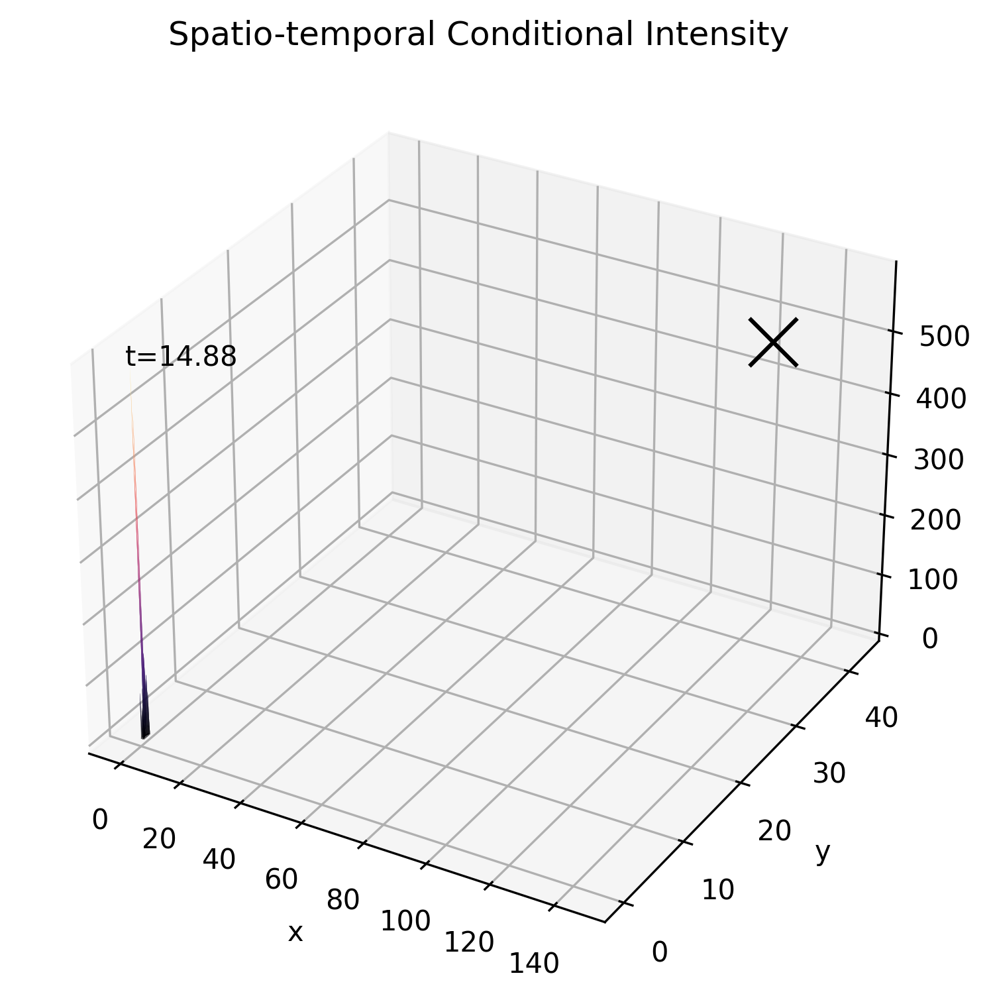

In [23]:

plot_lambst_static(lambs, x_range, y_range, t_range, history=(his_s, his_t), decay=2,
                        #scaler=da.st_scaler,
                         fps=12, fn=f'data_seq.mp4')